In [6]:
%load_ext autoreload
%autoreload 2
import numpy as np
import matplotlib.pylab as plt
import matplotlib.colors as colors
import matplotlib.patches as patches
import torchvision
import matplotlib.patches as patches
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d import Axes3D

import os
import time
import torch
import sys
import argparse
sys.path.insert(0, '../../shared_code')
from model_loader_func import * 
from dataloader_func import *
from quality_metrics_func import *
from linear_approx import *
from inverse_tasks_func import synthesis
from plotting_func import *
from algorithm_inv_prob import * 
from trainer import make_loader
%matplotlib inline

In [7]:
print(torch.__version__)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
device

2.5.0+cu124


device(type='cuda')

In [3]:
compute_UNet_RF(num_enc_conv=[2,2,2,2],  num_mid_conv=3, kernel_size=3)

172

# functions 

In [4]:
## plotting stuff: 
noise_colormap = plt.cm.copper 
scale_colormap = plt.cm.seismic
block_names = ['enc0','enc1' , 'enc2', 'mid', 'dec2', 'dec3']

In [7]:
similarity_matrix = lambda data : data/data.norm(dim = 1, keepdim=True) @(data/data.norm(dim = 1, keepdim=True)).T

degree_matrix = lambda sim_mat : torch.diag(sim_mat.sum(dim = 1))

participation_ratio = lambda v :  (v.norm(1)**2)/v.norm(2)**2/len(v)
participation_ratio_dataset = lambda data :  (data.norm(1, dim = 1)**2)/data.norm(2,dim = 1)**2/data.shape[1]


# Load denoisers 

In [17]:
denoisers = {}

root_path = '/mnt/home/zkadkhodaie/ceph/22_representation_in_UNet_denoiser/denoisers/'

paths = { 
         # 'mixture-color': 'UNet_flex/imagenet/0to300_RF_84x84_set_size_1232457_color_64x64/',
         # 'mixture-color-large-no-skip':'UNet_flex/imagenet/0to300_RF_232x232_set_size_1232457_color_no_skips_64x64/',       
         # 'mixture-color-large':'UNet_flex/imagenet/0to300_RF_232x232_set_size_1232457_color_64x64/',                  
         'mixture-color-deep-no-skip-256mid':'UNet_flex/imagenet/0to255_RF_84x84_set_size_1232457_color_no_skip_deep_dec_256mid_64x64/',    
         'mixture-color-deep-no-skip':'UNet_flex/imagenet/0to255_RF_84x84_set_size_1232457_color_no_skip_deep_dec_64x64/',
         'mixture-color-deep-no-skip-1024mid':'UNet_flex/imagenet/0to255_RF_68x68_set_size_1232457_color_no_skip_deep_dec_1024mid_64x64/',
    
         # 'mixture-modified-color': 'UNet_flex/imagenet/0to300_RF_84x84_set_size_1232457_color_64x64/',
         # 'mixture-modified-color-large-no-skip':'UNet_flex/imagenet/0to300_RF_232x232_set_size_1232457_color_no_skips_64x64/',
         # 'mixture-modified-color-large':'UNet_flex/imagenet/0to300_RF_232x232_set_size_1232457_color_64x64/',
         
         # 'mixture-modified-color-deep-no-skip':'UNet_flex/imagenet/0to255_RF_84x84_set_size_1232457_color_no_skip_deep_dec_64x64/',
    
        }

groups = paths.keys()


for group in groups: 
    path = root_path + paths[group]
    
    print('loading group ' , group )
    if 'modified' in group.split('-'):
        new_arch = 'UNet_conditional_mean_matching'
    else: 
        new_arch = None
    denoisers[group] = load_learned_model(path, print_args=True, new_arch=new_arch)
    start_time_total = time.time()        
    print("--- %s seconds ---" % (round(time.time() - start_time_total)))
     

loading group  mixture-color-deep-no-skip-256mid
*************** saved arguments:*************
arch_name UNet_flex
lr 0.001
batch_size 1024
num_epochs 1500
lr_freq 100
loss_weight False
noise_level_range [0, 255]
quadratic_noise True
rescale False
swap False
set_size 1232457
imagenet_subset_ids None
data_name imagenet
data_root_path /mnt/home/zkadkhodaie/ceph/datasets/
dir_name /mnt/home/zkadkhodaie/ceph/22_representation_in_UNet_denoiser/denoisers/UNet_flex/imagenet/0to255_RF_84x84_set_size_1232457_color_no_skip_deep_dec_256mid_64x64
optional_dir_label color_no_skip_deep_dec_256mid
device cuda
debug False
kernel_size 3
padding 1
skip False
num_channels 3
bias True
RF 84
coarse True
self_cond False
num_kernels [64, 128, 256, 256]
num_blocks 3
num_enc_conv [2, 2, 2]
num_mid_conv 3
num_dec_conv [6, 6, 6]
NormType LayerNorm
inter_skip True
dilations None
upsample_with_bias False
data_path /mnt/home/zkadkhodaie/ceph/datasets/imagenet
******************************************************
n

In [18]:
denoisers.keys()

dict_keys(['mixture-color-deep-no-skip-256mid', 'mixture-color-deep-no-skip', 'mixture-color-deep-no-skip-1024mid'])

# Load datasets 

In [10]:
time0 = time.time()
test_sets = torch.load( '/mnt/home/zkadkhodaie/ceph/datasets/imagenet/test_64x64_color_list.pt', weights_only=True) 
print(f"loading time: {time.time() - time0} seconds ")

loading time: 1.4140100479125977 seconds 


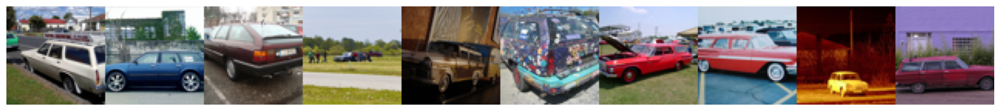

In [11]:
show_im_grid(test_sets[0][0:10] )


In [12]:
print('number of images in each class:', test_sets[0].shape)
K = test_sets[0].shape[2]
n_channels = test_sets[0].shape[1]
print(len(test_sets))

number of images in each class: torch.Size([49, 3, 64, 64])
999


tensor(0.4428)


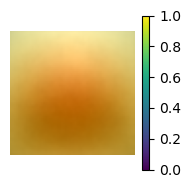

In [12]:
dist_mean = torch.concatenate(test_sets).mean(dim = (0))
plot_single_im(dist_mean, colorbar=True)
print(dist_mean.mean())

In [13]:
dist_mean.mean(dim = (1,2), keepdim = True)

tensor([[[0.4773]],

        [[0.4508]],

        [[0.4001]]])

In [14]:
test_sets_cat = torch.concatenate(test_sets)
test_sets_cat.shape

torch.Size([49051, 3, 64, 64])

120


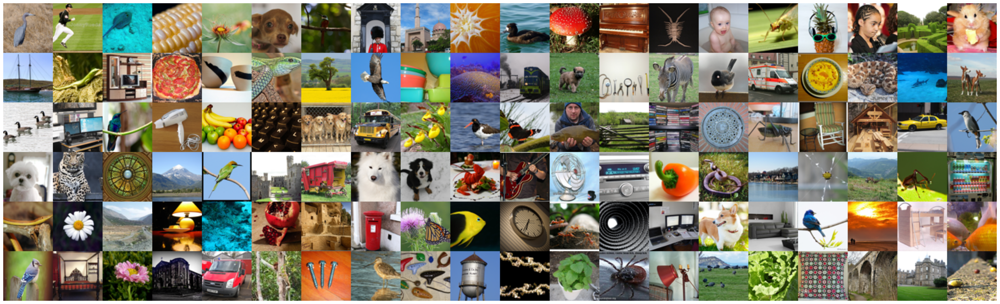

In [15]:
my_ids = [5, 31, 40, 46, 53, 58, 59,50+17, 50+45,104, 105, 117, 118, 124, 130,139 ,142, 150, 169, 179, 183, 186, 190,202, 209, 214, 229, 237, 260, 261, 275, 277, 288,291 , 307, 310, 316,336, 343,348,350,357,362,376,394,396, 
         408, 419, 440, 443, 459, 461, 486, 488,500, 524,525, 536, 546,570,572, 574, 576, 582,597, 603, 606,609, 615,622,636,651,660, 663,679,686, 692, 705,709,710,713,716,729, 746,747,752,761,763, 786,790,793,796, 
         802, 844, 846,851, 853,864,870,878,887,889, 891,  907, 909, 910, 919, 920, 921,930, 937,954, 956, 957,960, 968, 980, 992, 993,  995 ]

my_ims = torch.cat([test_sets[i][0:1] for i in my_ids ])
print(len(my_ids))
show_im_grid(my_ims, n_columns=20)



$\phi(y)$ or the mean of the channel is a function of noise realization, noise level, and input image. 

- **noise realization**: We take the average of $\phi(y)$ at a noise level, for one image to remove the effect of noise realization. 

- **noise level**: We observe that the $\phi(y_{\sigma})$ and $\phi(y_{\sigma})$ at two different noise levels are highly related: first, active channels are mostly shared at different noise levels. Specially at intermediate and larger noise levels. There are more active channels at high noise levels and they include active channels at smaller noise levels. Second, they are highly correlated. That means they are aligned and differ by a poitive scalre value.

- **input image $x$**: after getting rid of noise effect, we can look at how $\phi(y)$ changes from image to image. We can interpret $\phi(y)$ as a good approximation of $\phi(x)$. Now we ask if  Euclidean distance in latent space $\Vert \phi(x_1) -  \phi(x_2) \Vert_2$ is meaningfully related to $\mathcal{D}(x_1, x_2)$ where $\mathcal{D}$ is a some distance metric between the two images. Since $\phi(x)$ is a many to one mapping, we can define a distance between the density of all images mapping to $\phi(x_1)$ and the density of all images mapping to $\phi(x_2)$, that is $\mathcal{D}( p(x|\phi(x_1), p(x|\phi(x_2)) )$. 

In [19]:
layers = {}
for group in groups:
    layers[group] = []
    for i in range(len(denoisers[group].encoder)):
        layers[group].append(denoisers[group].encoder[str(i) ][0].weight.shape[0])
    
    layers[group].append(denoisers[group].mid[0].weight.shape[0])
    
    for i in range(len(denoisers[group].decoder)-1 , 0, -1):
        layers[group].append(denoisers[group].decoder[str(i) ][0].weight.shape[0])


layers

{'mixture-color-deep-no-skip-256mid': [64, 128, 256, 256, 256, 128],
 'mixture-color-deep-no-skip': [64, 128, 256, 512, 256, 128],
 'mixture-color-deep-no-skip-1024mid': [64, 128, 256, 1024, 256, 128]}

In [200]:
# a_bars = torch.load('../results/phis_noise_ave_all_scales_64x64_mixture-color-no-skip-deep_imagenet.pt', weights_only=True)
a_bars = {}
for group in groups: 
    print(group)
    a_bars[group] = torch.load('../results/phis_all_scales_64x64_'+group+'_imagenet.pt', weights_only = True)


mixture-color-deep-no-skip-256mid
mixture-color-deep-no-skip
mixture-color-deep-no-skip-1024mid


In [286]:
sigmas = list(a_bars[group].keys())
if sigmas[-1] < sigmas[0]:
    sigmas.reverse()
sigmas

[0, 10, 50, 150, 255]

## Always off channels 

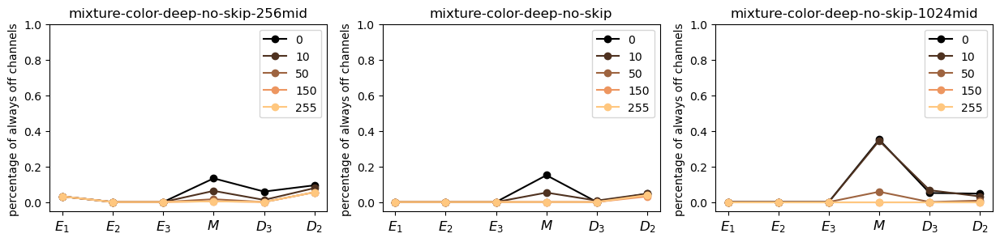

In [700]:
f, axs = plt.subplots(1, len(groups), figsize = ( len(groups)*5, 3) )
block_names = ['$E_1$','$E_2$' , '$E_3$', '$M$', '$D_3$','$D_2$']

j = 0
for group in groups:
    off_channels = {}
    for sig in sigmas:
        off_channels[sig] = []
        k1 = 0
        for l in layers[group]: 
            phi_block = torch.cat(a_bars[group][sig])[:,k1:k1 + l]
            off_channels[sig].append((phi_block.sum(dim = 0) == 0).sum().item())
            k1 += l  
            
    plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(sigmas ))]
    
    c = 0
    for sig in sigmas:    
        axs[j].plot(block_names, torch.tensor(off_channels[sig])/torch.tensor(layers[group]), '-o', color = plot_colors[c],  label = sig)
        c+= 1
    axs[j].set_ylabel('percentage of always off channels ');
    axs[j].set_ylim(-.05,1)
    axs[j].legend();
    axs[j].set_title(group);
    j += 1

In [10]:
val_sets = torch.load( '/mnt/home/zkadkhodaie/ceph/datasets/imagenet/validation_color_full_64x64_list.pt', weights_only=True) 


In [12]:
phis_val = torch.load( '/mnt/home/zkadkhodaie/projects/22_representation_in_UNet_denoiser/results/phis_noise_ave_validation_full_mixture-color-no-skip-deep_imagenet64x64.pt', weights_only=True) 


In [20]:
group = 'mixture-color-deep-no-skip'

In [8]:
import torch.nn as nn

# --- Linear Classifier Model ---
class LinearClassifier(nn.Module):
    def __init__(self, input_dim, output_dim):
        super().__init__()
        self.fc = nn.Linear(input_dim, output_dim)

    def forward(self, x):
        return self.fc(x)

model = LinearClassifier(512, 1000).cuda()


In [72]:
learned_params =torch.load('/mnt/ceph/users/zkadkhodaie/22_representation_in_UNet_denoiser/classifiers/linear/imagenet/model.pt', weights_only=True)


In [73]:
model.load_state_dict(learned_params)        
model.eval();

In [74]:
sig = 50

897
tensor([701, 701,  21, 871, 980, 701, 107, 392, 701, 701, 840, 701, 405, 981,
        701, 701, 584, 701, 701, 701, 701, 443, 701, 701, 701, 708, 701, 701,
        701, 701, 701, 557, 416, 701, 417, 701, 701, 701, 701, 701, 701, 649,
        701, 701, 701, 701, 701, 701, 895, 701], device='cuda:0')


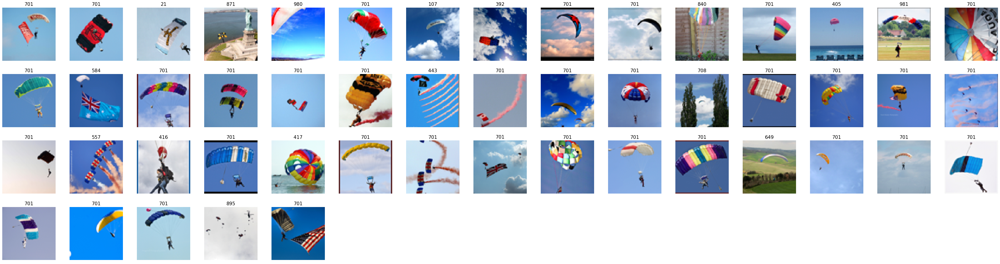

tensor([ 21, 107, 392, 405, 416, 417, 443, 557, 584, 649, 701, 708, 840, 871,
        895, 980, 981], device='cuda:0')

In [100]:
im_c = torch.randint(0, len(val_sets) , (1,)).cuda()
print(im_c.item())

im_c = 701
# im_c = 900
temp = model(phis_val[sig][im_c][0:50, sum(layers[group][0:3]):sum(layers[group][0:4]) ].cuda() )
print(temp.argmax(dim=1 ))
show_im_set( val_sets[im_c], n_columns=15 , sub_labels= temp.argmax(dim=1 ).cpu().numpy() )
temp.argmax(dim=1 ).unique()

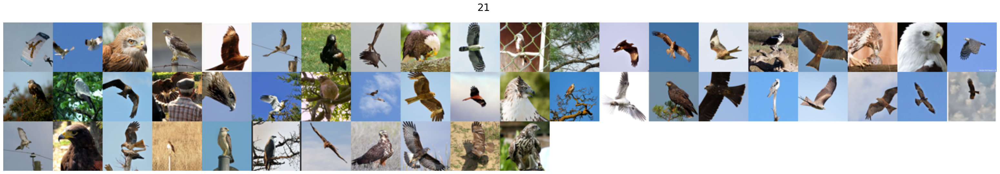

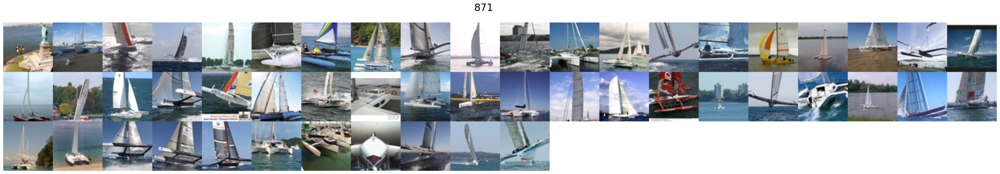

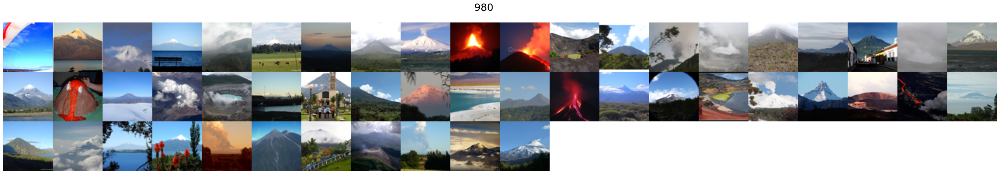

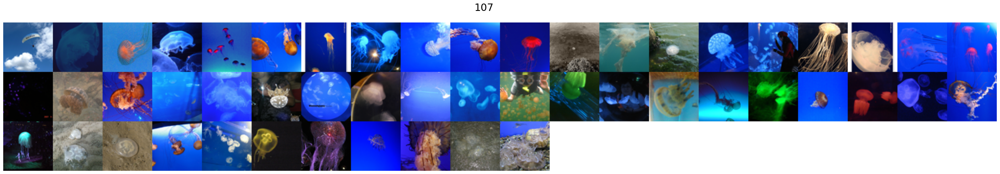

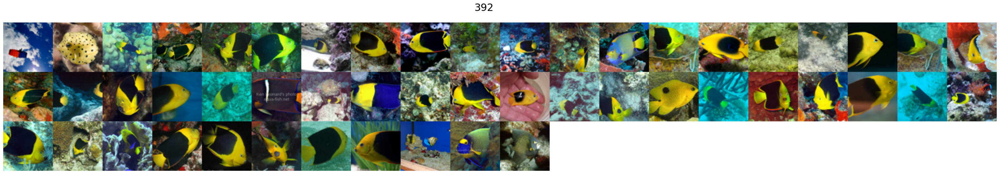

...

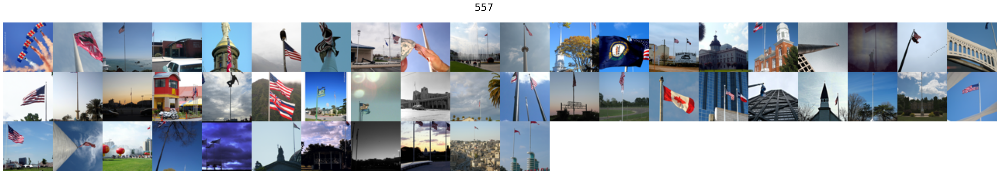

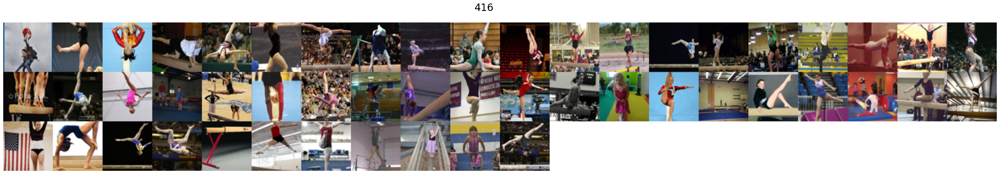

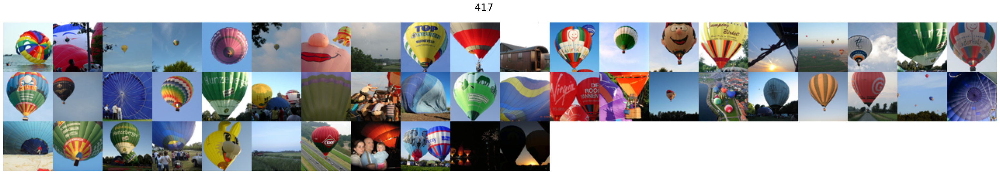

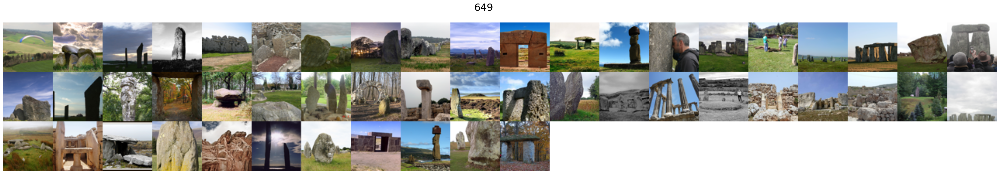

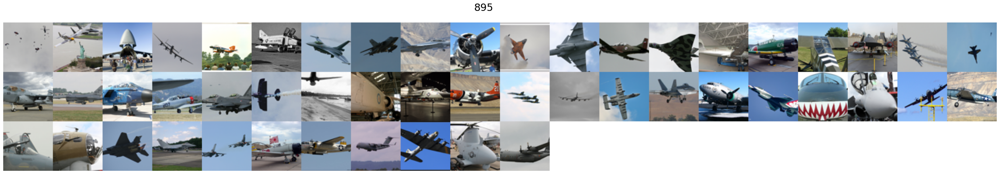

In [101]:
j = 0
for i in temp.argmax(dim=1 ):
    
    if i != im_c:
        show_im_grid( torch.vstack([val_sets[im_c][j: j+ 1],val_sets[i]]), n_columns=20 , label = i.item())
    j = j + 1